In [1]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')

In [2]:
# load data as dataframe
df = pd.read_csv('../datasets/energydata_complete.csv')

In [3]:
# show the first n rows
df.head(n=10)

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.890000,47.596667,19.20,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.500000,92.000000,7.000000,63.000000,5.300000,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.890000,46.693333,19.20,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.600000,92.000000,6.666667,59.166667,5.200000,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.890000,46.300000,19.20,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.700000,92.000000,6.333333,55.333333,5.100000,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.890000,46.066667,19.20,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.800000,92.000000,6.000000,51.500000,5.000000,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.890000,46.333333,19.20,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.900000,92.000000,5.666667,47.666667,4.900000,10.084097,10.084097
5,2016-01-11 17:50:00,50,40,19.890000,46.026667,19.20,44.500000,19.79,44.933333,18.890000,...,17.000000,45.29,6.016667,734.000000,92.000000,5.333333,43.833333,4.800000,44.919484,44.919484
6,2016-01-11 18:00:00,60,50,19.890000,45.766667,19.20,44.500000,19.79,44.900000,18.890000,...,17.000000,45.29,5.900000,734.100000,92.000000,5.000000,40.000000,4.700000,47.233763,47.233763
7,2016-01-11 18:10:00,60,50,19.856667,45.560000,19.20,44.500000,19.73,44.900000,18.890000,...,17.000000,45.29,5.916667,734.166667,91.833333,5.166667,40.000000,4.683333,33.039890,33.039890
8,2016-01-11 18:20:00,60,40,19.790000,45.597500,19.20,44.433333,19.73,44.790000,18.890000,...,17.000000,45.29,5.933333,734.233333,91.666667,5.333333,40.000000,4.666667,31.455702,31.455702
9,2016-01-11 18:30:00,70,40,19.856667,46.090000,19.23,44.400000,19.79,44.863333,18.890000,...,17.000000,45.29,5.950000,734.300000,91.500000,5.500000,40.000000,4.650000,3.089314,3.089314


In [4]:
# statistics
df.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,...,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,...,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,...,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,...,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,...,19.390000,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333,24.897653,24.897653
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,...,20.600000,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667,37.583769,37.583769
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,...,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


In [5]:
# data shape
print('Shape: ', df.shape)

Shape:  (19735, 29)


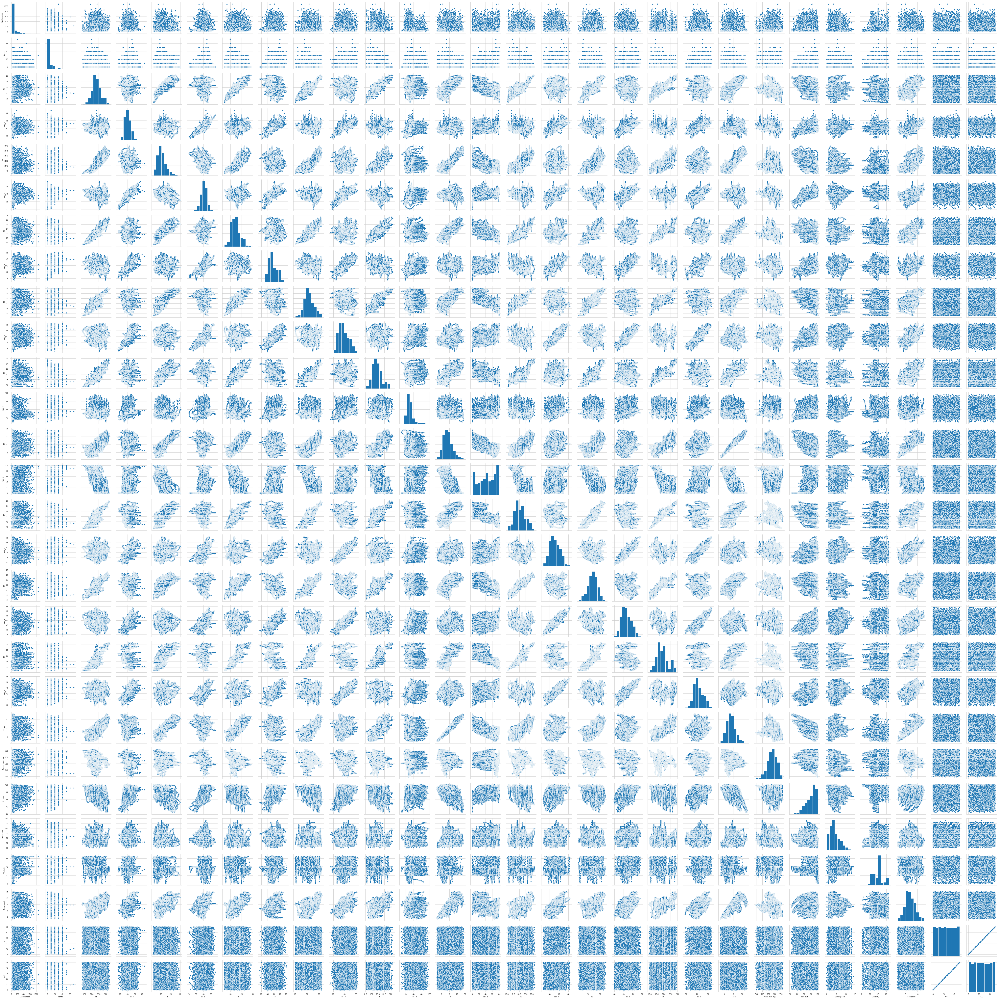

In [6]:
# plot pairwise relationships in a dataset
sns.pairplot(df);

In [40]:
# X: Hours, y: Scoures
# convert dataframe to array
X = np.array(df['T8']).reshape(-1, 1)
y = np.array(df['Appliances']).reshape(-1, 1)

In [41]:
# split data with library
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)


# split data without library
"""
Training: 15, Testing: 10
X_train = np.array(X[:15]).reshape(-1, 1)
y_train = np.array(y[:15]).reshape(-1, 1)
X_test = np.array(X[15:]).reshape(-1, 1)
y_test = np.array(y[15:]).reshape(-1, 1)
"""

'\nTraining: 15, Testing: 10\nX_train = np.array(X[:15]).reshape(-1, 1)\ny_train = np.array(y[:15]).reshape(-1, 1)\nX_test = np.array(X[15:]).reshape(-1, 1)\ny_test = np.array(y[15:]).reshape(-1, 1)\n'

In [42]:
print(X_train.shape)
print(X_test.shape)

(11841, 1)
(7894, 1)


In [43]:
# set parameters
reg = LinearRegression(fit_intercept=True, normalize=True)

In [44]:
# training
reg.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=True)

In [46]:
# Result
coef = reg.coef_
intercept = reg.intercept_
score = reg.score(X_test, y_test)
print('y:Appliances = {} * X:T8 + {}'.format(coef, intercept))
print('R^2 = {}'.format(score))

y:Appliances = [[2.04085727]] * X:T8 + [51.99440887]
R^2 = 0.0012962597131304099


In [20]:
# predict y:'Scores' using test samples
y_pred = reg.predict(X_test)

In [21]:
y_pred

array([[19.43037312],
       [20.57265566],
       [20.00151439],
       ...,
       [20.77445891],
       [20.812535  ],
       [18.41374165]])

In [22]:
# MSE
print('MSE =', mean_squared_error(y_test, y_pred))

MSE = 1.4276824756477131


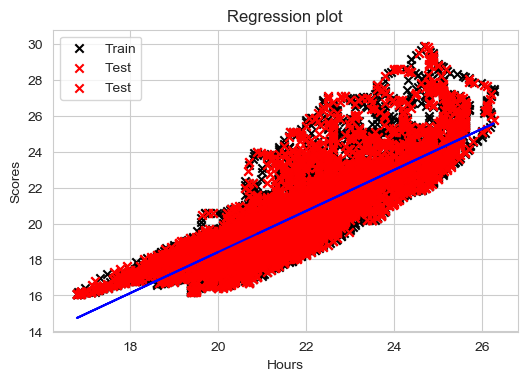

In [23]:
# Plot outputs
plt.figure(figsize=(6, 4), dpi=100)
plt.scatter(X_train, y_train, marker='x', color='black', label='Train')
plt.scatter(X_test, y_test, marker='x', color='red', label='Test')
plt.scatter(X_test, y_test, marker='x', color='red', label='Test')
plt.plot(X_test, y_pred, color='blue')
plt.title('Regression plot')
plt.xlabel('Hours')
plt.ylabel('Scores')
plt.legend()

MSE = 16925.20482580012
